<a href="https://colab.research.google.com/github/ibonetc/Esp_IA/blob/main/DeepLearning/IA_DL_YOLOv4_prueba.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Ejemplo de detección de objetos con YoloV4
===

Vamos a utilizar el modelo tf2_yolov4 desarrollado por https://github.com/sicara/tf2-yolov4/archive/master.zip para probar cómo utilizarlo.

Para eso es necesario:

1. Instalar el modelo.
2. Descargar los pesos de darknet YoloV4 entrenada con la base de datos COCO y convertirlos a pesos de tensorflow h5.
3. Utilizar el modelo en un ejemplo.

## 1. Instalar `tf2_yolov4` + TensorFlow

In [1]:
!pip install --no-cache-dir https://github.com/sicara/tf2-yolov4/archive/master.zip

     / 2.7 MB 564 kB/s
     |████████████████████████████████| 679 kB 7.3 MB/s 
  Created wheel for tf2-yolov4: filename=tf2_yolov4-0.1.0-py3-none-any.whl size=20156 sha256=ca7928b074eafaa79d0c7412c3fa60703f4749cb3b3d7ff2f97e3aa2b4c64e9b
  Stored in directory: /tmp/pip-ephem-wheel-cache-fgxycbxp/wheels/56/ba/d4/430cf7011ba67118d957b8d5b3d46b312eca092cde0ba9638c
Successfully built tf2-yolov4


`tf2_yolov4` tiene un script `convert-darknet-weights`, para convertir los pesos darknet (*.weights) a un fichero de pesos de tensorflow weights (*.h5):

## 2. Descargar los pesos de la red preentrenada con COCO
Descargamos `yolov4.weights` desde [AlexeyAB/darknet](https://github.com/AlexeyAB/darknet#how-to-evaluate-ap-of-yolov4-on-the-ms-coco-evaluation-server).

In [2]:
!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1cewMfusmPjYWbrnuJRuKhPMwRe_b9PaT' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1cewMfusmPjYWbrnuJRuKhPMwRe_b9PaT" -O yolov4.weights
!rm -rf /tmp/cookies.txt
!ls -la ./yolov4.weights

--2021-07-29 21:22:32--  https://docs.google.com/uc?export=download&confirm=LDnI&id=1cewMfusmPjYWbrnuJRuKhPMwRe_b9PaT
Resolving docs.google.com (docs.google.com)... 142.250.101.139, 142.250.101.101, 142.250.101.113, ...
Connecting to docs.google.com (docs.google.com)|142.250.101.139|:443... connected.
HTTP request sent, awaiting response... 302 Moved Temporarily
Location: https://doc-00-3k-docs.googleusercontent.com/docs/securesc/q0s8p7eq0sfqim3kk7urfceobumhnlfl/rbo27jnad9g0gbf0m7ilc51n8d2heq5g/1627593750000/14889149095783116612/10270359738313939855Z/1cewMfusmPjYWbrnuJRuKhPMwRe_b9PaT?e=download [following]
--2021-07-29 21:22:33--  https://doc-00-3k-docs.googleusercontent.com/docs/securesc/q0s8p7eq0sfqim3kk7urfceobumhnlfl/rbo27jnad9g0gbf0m7ilc51n8d2heq5g/1627593750000/14889149095783116612/10270359738313939855Z/1cewMfusmPjYWbrnuJRuKhPMwRe_b9PaT?e=download
Resolving doc-00-3k-docs.googleusercontent.com (doc-00-3k-docs.googleusercontent.com)... 74.125.137.132, 2607:f8b0:4023:c03::84
Connec

In [3]:
!convert-darknet-weights yolov4.weights -o yolov4.h5
#!ls -la ./yolov4.h5

2021-07-29 21:23:05.758336: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
2021-07-29 21:23:07.287167: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcuda.so.1
2021-07-29 21:23:07.353840: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-07-29 21:23:07.354778: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1733] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.75GiB deviceMemoryBandwidth: 298.08GiB/s
2021-07-29 21:23:07.354840: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
2021-07-29 21:23:07.470249: I tensorflow/stream_executor/platform/default

Importar tensorflow, tf2_yolov4 y anchors

In [5]:
import tensorflow as tf

from tf2_yolov4.anchors import YOLOV4_ANCHORS
from tf2_yolov4.model import YOLOv4

HEIGHT, WIDTH = (640, 960)

Crear el modelo con los pesos

In [6]:
model = YOLOv4(
    input_shape=(HEIGHT, WIDTH, 3),
    anchors=YOLOV4_ANCHORS,
    num_classes=80,
    training=False,
    yolo_max_boxes=100,
    yolo_iou_threshold=0.5,
    yolo_score_threshold=0.5,
)

model.load_weights("yolov4.h5")
model.summary()

Model: "YOLOv4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            [(None, 640, 960, 3) 0                                            
__________________________________________________________________________________________________
CSPDarknet53 (Functional)       [(None, 80, 120, 256 26652512    input_8[0][0]                    
__________________________________________________________________________________________________
YOLOv4_neck (Functional)        [(None, 80, 120, 128 15857152    CSPDarknet53[0][0]               
                                                                 CSPDarknet53[0][1]               
                                                                 CSPDarknet53[0][2]               
_____________________________________________________________________________________________

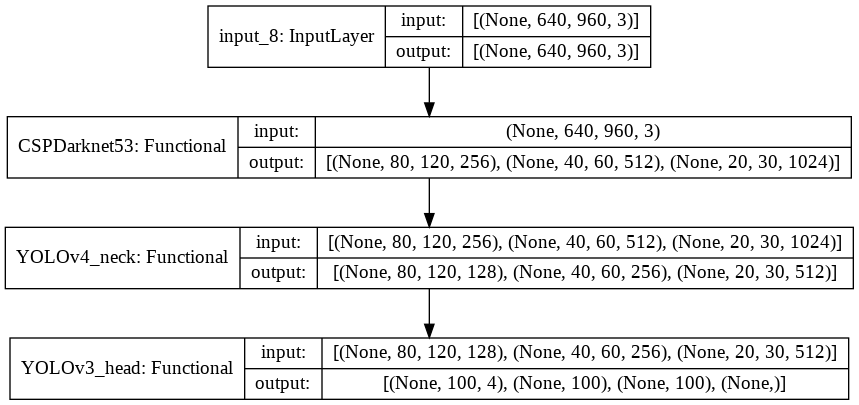

In [7]:
tf.keras.utils.plot_model(model, show_shapes=True)

## 3. Predecir

Probar la predicción en una imagen:

In [8]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [11]:
pathimage='/content/drive/MyDrive/Fotos_Pruebas/habana.jpg'

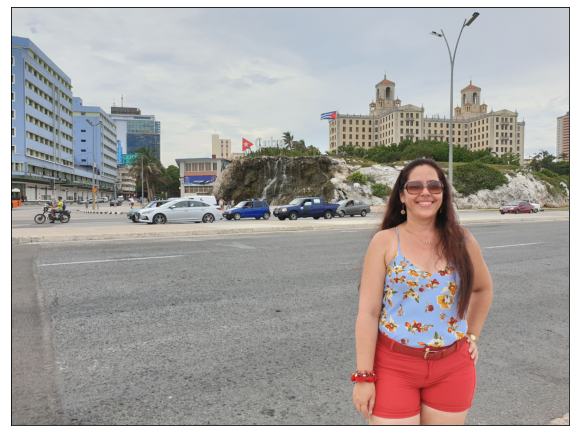

In [12]:
import matplotlib.pyplot as plt
img=plt.imread(pathimage)
plt.figure(figsize=(10,10))
plt.xticks([])
plt.yticks([])
plt.imshow(img)
plt.show()

Preprocesar una imagen

In [13]:
def preprocess_img(pathimage):
  img = tf.io.read_file(pathimage)
  img = tf.image.decode_image(img)
  img = tf.image.resize(img, (HEIGHT, WIDTH))
  imgs = tf.expand_dims(img, axis=0) / 255.0
  return imgs

Predecir

In [14]:
imgs=preprocess_img(pathimage)
boxes, scores, classes, valid_detections = model.predict(imgs)

In [15]:
print(classes[0][0], scores[0][0],boxes[0][0])

2.0 0.9945605 [0.37922376 0.46239024 0.46664232 0.5125826 ]


Dibujar los cuadros:

In [16]:
!wget https://github.com/pjreddie/darknet/blob/master/data/coco.names

--2021-07-29 21:25:47--  https://github.com/pjreddie/darknet/blob/master/data/coco.names
Resolving github.com (github.com)... 192.30.255.113
Connecting to github.com (github.com)|192.30.255.113|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/html]
Saving to: ‘coco.names’

coco.names              [ <=>                ] 135.32K  --.-KB/s    in 0.1s    

2021-07-29 21:25:47 (1.16 MB/s) - ‘coco.names’ saved [138564]



In [17]:
def load_classes(namesfile):
    fp = open(namesfile, "r")
    names = fp.read().split("\n")[:-1]
    return names

In [18]:
coco_classes=load_classes('/content/coco.names')

In [19]:
coco_classes

['',
 '',
 '',
 '',
 '',
 '',
 '<!DOCTYPE html>',
 '<html lang="en" data-color-mode="auto" data-light-theme="light" data-dark-theme="dark">',
 '  <head>',
 '    <meta charset="utf-8">',
 '  <link rel="dns-prefetch" href="https://github.githubassets.com">',
 '  <link rel="dns-prefetch" href="https://avatars.githubusercontent.com">',
 '  <link rel="dns-prefetch" href="https://github-cloud.s3.amazonaws.com">',
 '  <link rel="dns-prefetch" href="https://user-images.githubusercontent.com/">',
 '',
 '',
 '',
 '  <link crossorigin="anonymous" media="all" integrity="sha512-+z3z7w/QKK6v7DS9Y7YG7e3neIfYqIJaOykTRwMq4TdhAIQ7h3n7TCXttcuZDvdnaWPJV44oKM5vmkLhHO2ZHA==" rel="stylesheet" href="https://github.githubassets.com/assets/frameworks-fb3df3ef0fd028aeafec34bd63b606ed.css" />',
 '  ',
 '    <link crossorigin="anonymous" media="all" integrity="sha512-fT2DQxqNhDV1nNx3O++a8GI7qYYEW9SXVa1DFqueH7oHuDL9whJKb3TOAvI6HA8fH6nRcesnmlOqZEkTo1i0Ig==" rel="stylesheet" href="https://github.githubassets.com/asse

In [21]:
import numpy as np

In [22]:
# COCO classes
CLASSES = [
    'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant',
    'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse',
    'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack',
    'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis',
    'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove',
    'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass',
    'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich',
    'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake',
    'chair', 'couch', 'potted plant', 'bed', 'dining table',
    'toilet', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
    'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator',
    'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier',
    'toothbrush'
]

# colors for visualization
#COLORS = [[1, 0, 0], [0, 1, 0], [0, 0, 1],[0.494, 0.184, 0.556], [0.466, 0.674, 0.188]]
COLORSO = [[230, 25, 75], [60, 180, 75], [255, 225, 25], [0, 130, 200], [245, 130, 48], 
          [145, 30, 180],[70, 240, 240], [240, 50, 230], [210, 245, 60], [250, 190, 212], 
          [0, 128, 128], [220, 190, 255],[170, 110, 40], [255, 250, 200], [128, 0, 0], 
          [170, 255, 195], [128, 128, 0], [255, 215, 180], [0, 0, 128], [128, 128, 128]]
COLORS = (np.array(COLORSO)/255).tolist()

In [23]:
def plot_results(pil_img, boxes, scores, classes):
    plt.imshow(pil_img)
    ax = plt.gca()

    for (xmin, ymin, xmax, ymax), score, cl in zip(boxes.tolist(), scores.tolist(), classes.tolist()):
        if score > 0:
          color=COLORS[cl % len(COLORS)]
          ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                    fill=False, color=color, linewidth=5))
          text = f'{CLASSES[cl]}: {score:0.2f}'
          ax.text(xmin, ymin, text, fontsize=30,
                  bbox=dict(facecolor=color, alpha=0.5))
    plt.axis('off')
    plt.show()

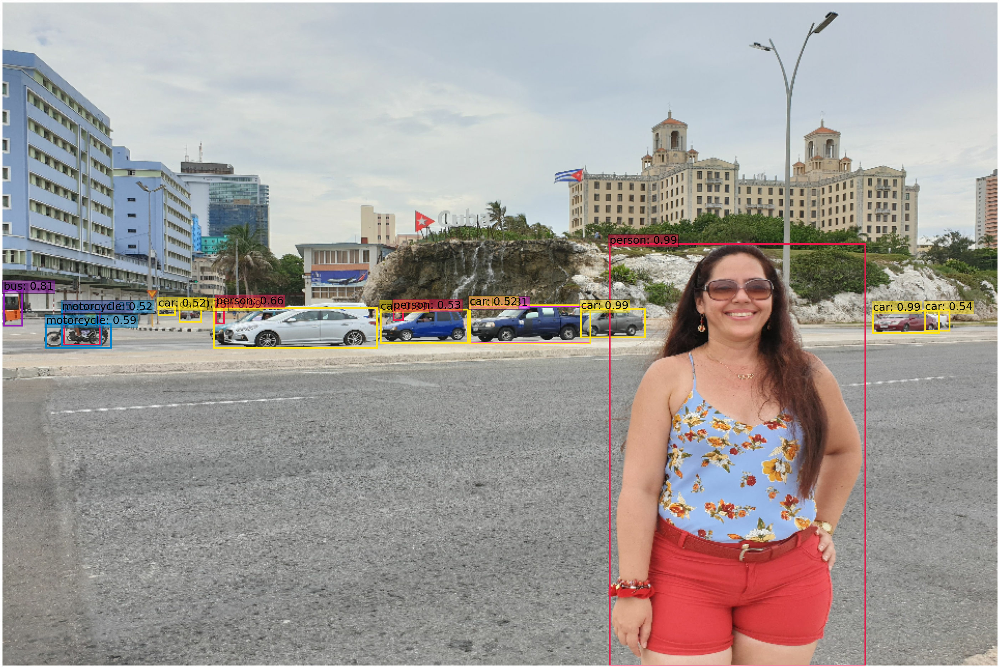

In [24]:
plt.figure(figsize=(50,60))
plot_results(imgs[0],boxes[0] * [WIDTH, HEIGHT, WIDTH, HEIGHT], scores[0], classes[0].astype(int))

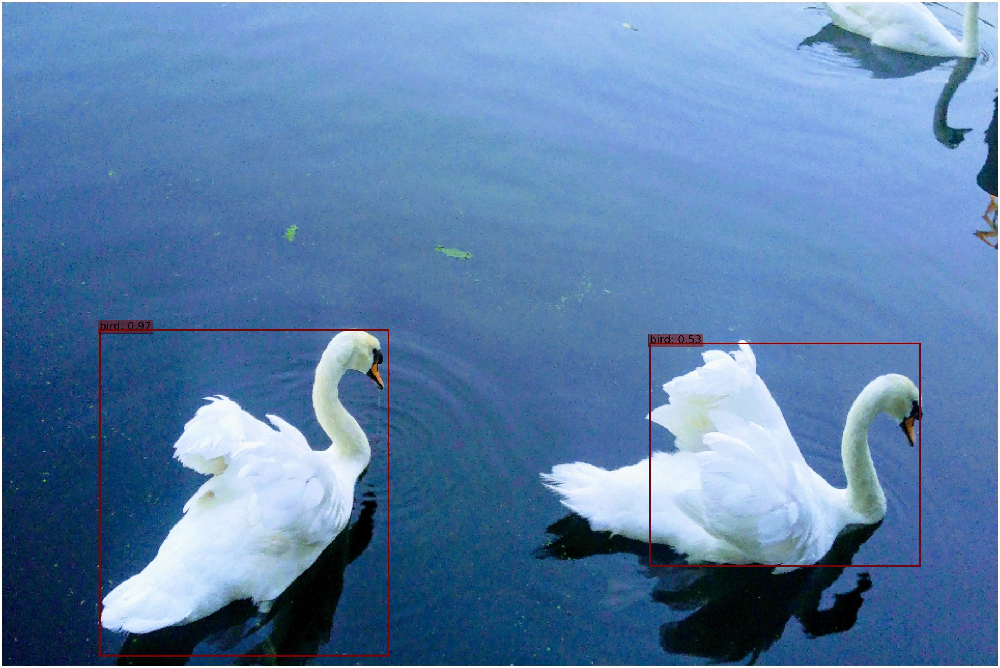

In [26]:
pathimage='/content/drive/MyDrive/Fotos_Pruebas/cisnes.jpg'
imgs=preprocess_img(pathimage)
boxes, scores, classes, valid_detections = model.predict(imgs)
plt.figure(figsize=(50,60))
plot_results(imgs[0], boxes[0] * [WIDTH, HEIGHT, WIDTH, HEIGHT], scores[0], classes[0].astype(int))

In [27]:
import numpy as np
import cv2

def draw_bounding_box(img, class_id, confidence, x, y, x_plus_w, y_plus_h, colors):
  label = str(CLASSES[class_id])
  color = COLORSO[class_id % len(COLORSO)]
  cv2.rectangle(img, (x,y), (x_plus_w,y_plus_h), color, 2)
  cv2.putText(img, label, (x-10,y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
  return img

In [28]:
def draw_rectangles(pathimage,boxes, scores, classes, colors):
  img = plt.imread(pathimage)
  img = cv2.resize(img, (WIDTH,HEIGHT))
  boxes= boxes * [WIDTH, HEIGHT, WIDTH, HEIGHT]
  for (xmin, ymin, xmax, ymax), score, cl in zip(boxes.tolist(), scores.tolist(), classes.tolist()):
    if score >= 0.5:
      img=draw_bounding_box(img, cl, score, round(xmin), round(ymin), round(xmax), round(ymax), colors)
  return img

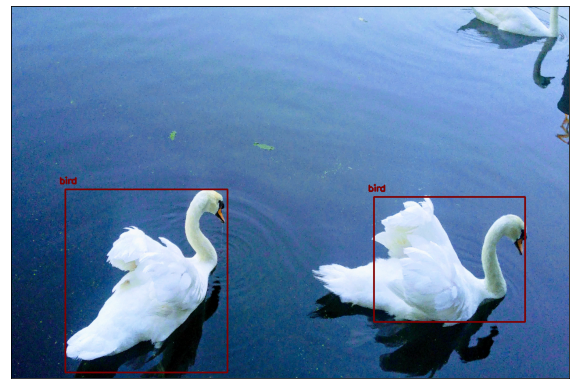

In [30]:
pathimage='/content/drive/MyDrive/Fotos_Pruebas/cisnes.jpg'
imgs=preprocess_img(pathimage)
boxes, scores, classes, valid_detections = model.predict(imgs)
COLORS = np.random.uniform(0, 255, size=(len(CLASSES), 3))
img=draw_rectangles(pathimage,boxes[0], scores[0], classes[0].astype(int), colors=COLORS)
plt.figure(figsize=(10,10))
plt.xticks([])
plt.yticks([])
plt.imshow(img)

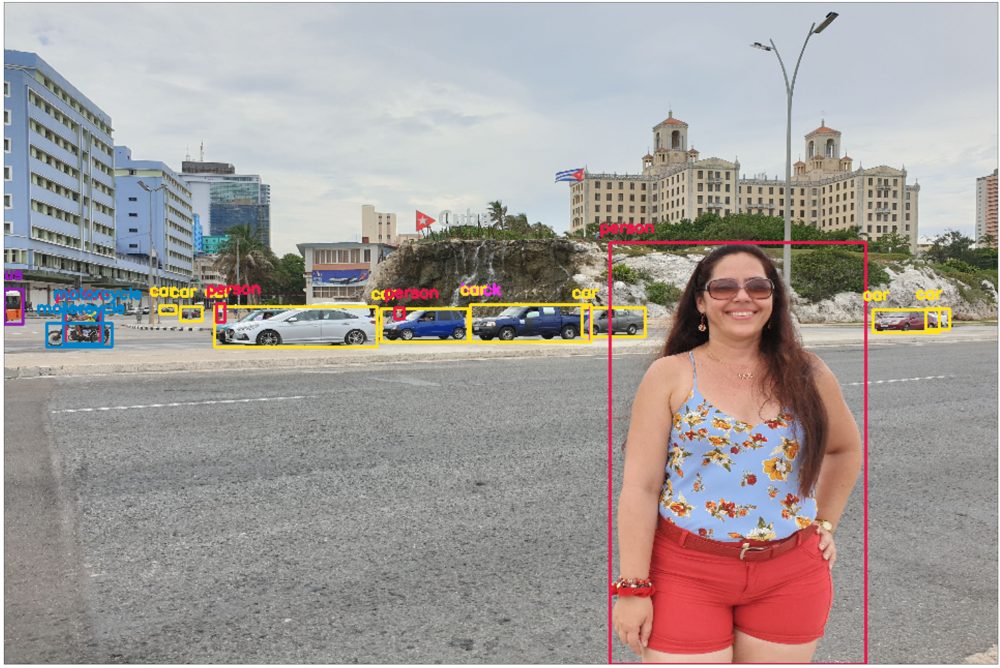

In [31]:
pathimage='/content/drive/MyDrive/Fotos_Pruebas/habana.jpg'
imgs=preprocess_img(pathimage)
boxes, scores, classes, valid_detections = model.predict(imgs)
img=draw_rectangles(pathimage,boxes[0], scores[0], classes[0].astype(int), colors=COLORS)
plt.figure(figsize=(50,80))

plt.xticks([])
plt.yticks([])
plt.imshow(img)

In [32]:
classes_l=np.unique(classes[0].astype(int)[scores[0]>=0.5])
classes_n_l=np.array(CLASSES)[classes_l.astype(int)].tolist()
color_l=[COLORS[c % len(COLORS)] for c in classes_l]

In [33]:
from matplotlib.lines import Line2D
custom_legend=[Line2D([0], [0],color= colL,lw=4) for colL in color_l]

In [ ]:
pathimage='/content/drive/MyDrive/Fotos_Pruebas/habana2.jpg'
imgs=preprocess_img(pathimage)
boxes, scores, classes, valid_detections = model.predict(imgs)
img=draw_rectangles(pathimage,boxes[0], scores[0], classes[0].astype(int), colors=COLORS)
plt.figure(figsize=(50,80))
plt.legend(custom_legend, classes_n_l, prop={'size':50})
plt.xticks([])
plt.yticks([])
plt.imshow(img)